In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import plotly.graph_objects as go
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import requests
import conf
from time import sleep
import json
from plotly.express.colors import sequential
from urllib.request import urlopen

/Users/mattheweng/anaconda/envs/GIS/lib/python3.6/site-packages/geopandas/plotting.py:389: FutureWarning:

'axes' is deprecated, please use 'ax' instead (for consistency with pandas)



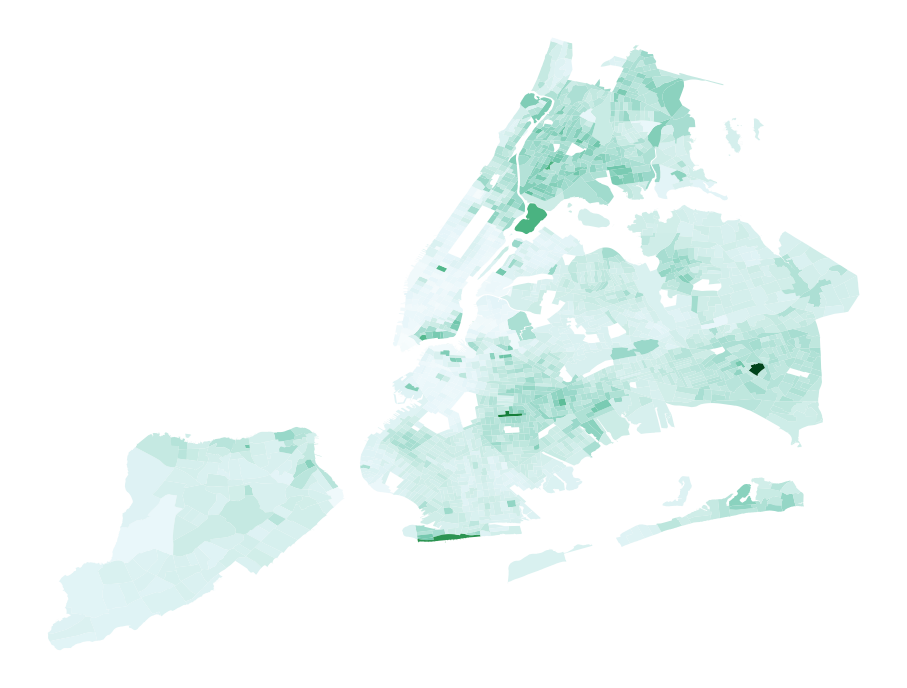

In [4]:
geo = gpd.read_file('../data/cityhealth-newyork-190506/CHDB_data_tract_NY v5_3_withgeo.geojson')

f, ax = plt.subplots(1, figsize=(16, 16))
ax = geo[['geometry', 'Diabetes']].dropna().plot(column="Diabetes", axes=ax, cmap='BuGn', k=9)
ax.set_axis_off()
plt.show()

# interactive chloropleth map

In [28]:

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.fips, z=df.unemp,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [5]:
geo

,Air pollution - particulate matter,Binge drinking,Children in Poverty,Dental care,Diabetes,Frequent mental distress,Frequent physical distress,High blood pressure,"Housing cost, excessive",Housing with potential lead risk,...,Limited access to healthy foods,Obesity,Physical inactivity,Preventive services,Racial/ethnic diversity,Smoking,Unemployment,Uninsured,fips_state_county_tract_code,geometry
0,9.9,23.2,NaN,41.5,10.3,17.7,14.8,28.6,NaN,NaN,...,100.0,35.6,35.7,20.8,62.4,29.0,NaN,NaN,36005000100,(POLYGON ((-73.87287195903875 40.7859750278047...
1,9.8,17.5,16.7,64.4,13.0,12.3,12.9,30.2,43.5,26.4,...,1.5,29.6,30.4,27.9,40.6,14.4,12.4,9.4,36005000200,(POLYGON ((-73.85651604096793 40.8052412204759...
2,9.8,18.3,21.4,67.7,11.9,11.7,11.8,28.0,43.2,15.8,...,4.8,29.9,27.4,29.3,50.9,13.2,7.4,5.3,36005000400,(POLYGON ((-73.84610660457847 40.8130999892054...
3,9.8,13.2,30.5,51.2,18.6,15.8,18.6,36.8,53.5,14.2,...,0.0,36.2,40.3,22.8,52.8,18.5,9.1,9.2,36005001600,(POLYGON ((-73.85513639815333 40.8224361893100...
4,9.9,19.1,23.9,56.7,11.6,14.5,13.5,27.8,54.9,33.5,...,0.0,32.7,31.1,26.0,68.5,18.3,13.4,17.6,36005001900,(POLYGON ((-73.89680883223774 40.7958084451597...
5,9.8,12.7,67.4,43.8,19.5,18.6,20.9,37.3,60.5,40.4,...,0.0,38.8,44.7,19.4,49.5,22.1,19.0,9.3,36005002000,(POLYGON ((-73.86246402703922 40.8192471541163...
6,9.9,11.5,64.5,39.1,21.8,20.0,23.5,40.0,52.4,36.7,...,0.0,40.1,49.0,18.1,47.9,23.2,18.2,9.3,36005002300,(POLYGON ((-73.92288629837282 40.8091058643894...
7,9.8,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,3.0,...,NaN,NaN,NaN,NaN,42.9,NaN,0.0,21.5,36005002400,(POLYGON ((-73.87050125579968 40.8203643603382...
8,9.9,14.9,58.1,45.6,16.7,17.7,19.0,31.7,61.0,45.8,...,0.0,36.2,42.3,20.2,40.7,20.7,6.5,17.8,36005002500,(POLYGON ((-73.91749751745247 40.8068136363794...
9,9.9,13.2,78.9,42.9,18.2,18.9,20.6,34.3,50.7,42.0,...,0.0,38.9,44.5,19.3,40.4,22.2,10.5,15.5,36005002701,(POLYGON ((-73.91352680723857 40.8042514259749...


In [23]:
[shape['id'] for shape in shapes['features'] if shape['id'] == '0']

['0']

In [25]:
geo.iloc[1981]['fips_state_county_tract_code']

'36081115700'

In [26]:
shapes = json.loads(geo['geometry'].apply(lambda x: x).to_json())

fig = go.Figure(go.Choroplethmapbox(geojson=shapes, 
                                    locations = [str(i) for i in geo.index.values],
                                    z=geo['Diabetes'],
                                    colorscale=sequential.PuRd, zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(
    mapbox_style="carto-positron",
                  mapbox_zoom=10, mapbox_center = {"lat": 40.7410224, "lon": -73.9939661})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
            
data = fig.data[0]

fig.show()

In [8]:
data

Choroplethmapbox({
    'colorscale': [[0.0, 'rgb(247,244,249)'], [0.125, 'rgb(231,225,239)'], [0.25,
                   'rgb(212,185,218)'], [0.375, 'rgb(201,148,199)'], [0.5,
                   'rgb(223,101,176)'], [0.625, 'rgb(231,41,138)'], [0.75,
                   'rgb(206,18,86)'], [0.875, 'rgb(152,0,67)'], [1.0,
                   'rgb(103,0,31)']],
    'geojson': {'bbox': [-74.25559136315213, 40.49611539517034, -73.7000090638712,
                         40.9155327770052],
                'features': [{'bbox': [-73.89282283610936, 40.78535662050845,
                                       -73.8707857400225, 40.79875053035696],
                              'geometry': {'coordinates': [[[[-73.87287195903875,
                                                           40.78597502780474],
                                                           [-73.87288496983653,
                                                           40.78596263321597],
                                      

In [27]:
import plotly.figure_factory as ff

import numpy as np
import pandas as pd

df_sample = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/laucnty16.csv')
df_sample['State FIPS Code'] = df_sample['State FIPS Code'].apply(lambda x: str(x).zfill(2))
df_sample['County FIPS Code'] = df_sample['County FIPS Code'].apply(lambda x: str(x).zfill(3))
df_sample['FIPS'] = df_sample['State FIPS Code'] + df_sample['County FIPS Code']

colorscale = ["#f7fbff", "#ebf3fb", "#deebf7", "#d2e3f3", "#c6dbef", "#b3d2e9", "#9ecae1",
    "#85bcdb", "#6baed6", "#57a0ce", "#4292c6", "#3082be", "#2171b5", "#1361a9",
    "#08519c", "#0b4083", "#08306b"
]
endpts = list(np.linspace(1, 12, len(colorscale) - 1))
# fips = df_sample['FIPS'].tolist()
# values = df_sample['Unemployment Rate (%)'].tolist()
fips = geo['fips_state_county_tract_code']
values = geo['Diabetes']

fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True,
    asp = 2.9,
    title_text = 'USA by Unemployment %',
    legend_title = '% unemployed'
)
fig.layout.template = None
fig.show()